In [3]:
import pylablib.aux_libs.devices.DCAM as cam
from pylablib.aux_libs.devices.DCAM_lib import lib, DCAMLibError

import matplotlib.pyplot as plt
import sys
import numpy as np 

from time import sleep
import logging
import warnings
from skimage import io

In [4]:
from zaber_motion import Library
from zaber_motion.binary import Connection
from zaber_motion import Units
Library.enable_device_db_store()

In [5]:
conn.close()

NameError: name 'conn' is not defined

In [ ]:
conn = Connection.open_serial_port('COM5')
devList = conn.detect_devices()
print('Found {} devices'.format(len(devList)))
zdrive = devList[0]
    
zdrive.home()


## Test zaber 

In [81]:
zdrive.home()

0.0

In [4]:
zdrive.move_absolute(2.54, Units.LENGTH_CENTIMETRES)

2.5399984125

## Start cam 

In [5]:
cam0 = cam.DCAMCamera(0)
lib.dcamapi_uninit()     # For some reason this must be run before opening the camera
cam0.open()

min_texp = cam0.properties['EXPOSURE TIME'].min
cam0.set_value('EXPOSURE TIME', min_texp)

0.0010036691729323308

In [78]:
cam0.set_value('EXPOSURE TIME', 0.1)

0.10000637593984962

In [71]:
cam0.stop_acquisition()

In [72]:
cam0.start_acquisition(mode='sequence')

In [56]:
frame

array([[[ 97, 100, 113, ..., 105, 103,  97],
        [100, 102, 102, ..., 100,  99,  99],
        [ 98, 101, 100, ..., 105,  94,  99],
        ...,
        [ 99, 102,  98, ...,  99, 103,  97],
        [101,  94, 100, ...,  97, 104, 100],
        [ 99, 101,  95, ...,  98,  99, 101]]], dtype=uint16)

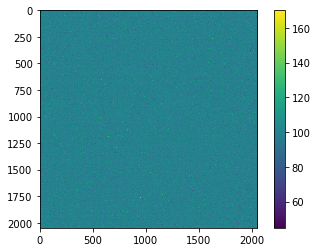

In [77]:
frame = cam0.get_frame(buffer=cam0.get_buffer_size())
bar = plt.imshow(frame)
plt.colorbar(bar)

# Record z scan every 10 um 

In [34]:
frame.argmax(axis=0)
#frame[frame.argmax()]

783

## Sample A 

In [86]:
zdrive.move_absolute(9, Units.LENGTH_MILLIMETRES)

8.999982

In [188]:
nframes = 1

zdrive.move_absolute(2.54, Units.LENGTH_CENTIMETRES)

mx = []
for i in range(1000):
    snapav = []
    for i in range(nframes):
        frame = cam0.get_frame(buffer=cam0.get_buffer_size())
        #roi = bound_roi(frame, size=2) # select 10x10 pixel roi around max
        snapav.append(frame) # snapav.append(frame) for total image averaging
    snap = np.average(np.array(snapav), axis=0)  # average over nframes
    
    mx.append(snap.max())
    zdrive.move_relative(10, Units.LENGTH_MICROMETRES)

Text(0, 0.5, '$I_{max}$ [G.L.]')

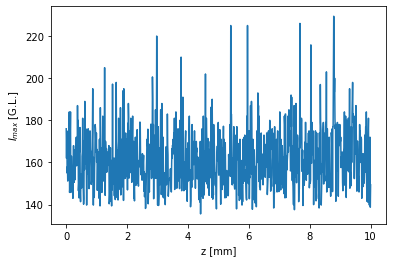

In [189]:
xarr = np.linspace(0, len(mx)/100, len(mx))

plt.plot(xarr, mx)
plt.xlabel('z [mm]')
plt.ylabel('$I_{max}$ [G.L.]')

## With sample B

In [ ]:
zdrive.move_absolute(10, Units.LENGTH_MILLIMETRES)

def z_profile(cam0, zdrive, nframes: int = 5, step: int = 10, step_units = Units.LENGTH_MICROMETRES, zrange: int = 200) -> list:
    """Move zaber actuator in z, take nframes, store maximum intensity over the average of them at each step
    Parameters:
    cam0: Hamamatsu.DCAM object, must be initialized and set
    zdrive: zaber_motion object, also initialized and homed
        move by relative steps
    nframes: int, number of frames to average over each step
    step: int, z increment by zaber actuator
    step_units, units [Units.LENGTH_MILLIMETRES, Units.LENGTH_MICROMETERS, etc]
    zrange: total number of steps to jog
    
    Returns:
    mx: list, maximum intensity value at each step"""

    mx = []
    for i in range(zrange):
        snapav = []
        for i in range(nframes):
            frame = cam0.get_frame(buffer=cam0.get_buffer_size())
            #roi = bound_roi(frame, size=2) # select 10x10 pixel roi around max
            snapav.append(frame) # snapav.append(frame) for total image averaging
        snap = np.average(np.array(snapav), axis=0)  # average over nframes

        mx.append(snap.max())
        zdrive.move_relative(step, step_units)
        
        return mx

In [190]:
nframes = 5

zdrive.move_absolute(10, Units.LENGTH_MILLIMETRES)

mx = []
for i in range(1000):
    snapav = []
    for i in range(nframes):
        frame = cam0.get_frame(buffer=cam0.get_buffer_size())
        #roi = bound_roi(frame, size=2) # select 10x10 pixel roi around max
        snapav.append(frame) # snapav.append(frame) for total image averaging
    snap = np.average(np.array(snapav), axis=0)  # average over nframes
    
    mx.append(snap.max())
    zdrive.move_relative(10, Units.LENGTH_MICROMETRES)

Text(0, 0.5, '$I_{max}$ [G.L.]')

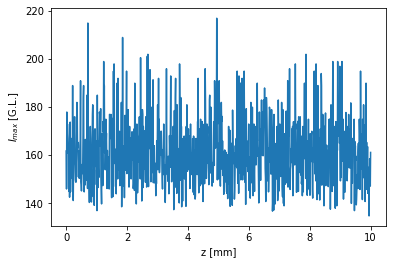

In [191]:
xarr = np.linspace(0, len(mx)/100, len(mx))

plt.plot(xarr, mx)
plt.xlabel('z [mm]')
plt.ylabel('$I_{max}$ [G.L.]')

# Try at 1 um per step

## Sample A

In [154]:
nframes = 5

zdrive.move_absolute(10, Units.LENGTH_MILLIMETRES)

mx = []
for i in range(1000):
    snapav = []
    for i in range(nframes):
        frame = cam0.get_frame(buffer=cam0.get_buffer_size())
        roi = bound_roi(frame, size=5) # select 10x10 pixel roi around max
        snapav.append(roi) # snapav.append(frame) for total image averaging
    snap = np.average(np.array(snapav), axis=0)  # average over nframes
    
    mx.append(snap.max())
    zdrive.move_relative(1, Units.LENGTH_MICROMETRES)

Text(0, 0.5, '$I_{max}$ [G.L.]')

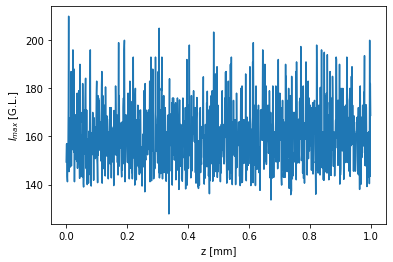

In [155]:
xarr = np.linspace(0, len(mx)/1000, len(mx))

plt.plot(xarr, mx)
plt.xlabel('z [mm]')
plt.ylabel('$I_{max}$ [G.L.]')

# Improve efficiency: take maximum in a 5x5 pixel ROI 

In [148]:
snapar = np.array(snapav)

In [153]:
snapar = np.array(snapav)
snap = np.average(snapar, axis=0)
snap.max()

141.0

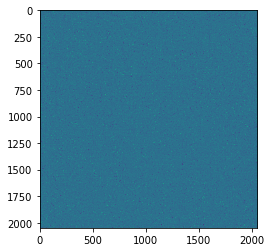

In [158]:
plt.imshow(snap)

In [173]:
def bound_roi(im : np.ndarray, size : int = 200):
    """im : image in grayscale
       size : 1/2*max size of the roi
       if size > mx: take bound to be 0 or im.shape[]"""
    mx = np.unravel_index(im.argmax(), im.shape)
    bounds_roi = []
    for m in mx:
        if 0 < m - size:
            bounds_roi.append(m - size)
        else: bounds_roi.append(0)
        if m + size < im.shape[0]:
            bounds_roi.append(m + size)
        else: bounds_roi.append(im.shape[0])
    return im[bounds_roi[0] : bounds_roi[1], bounds_roi[2] : bounds_roi[3]]

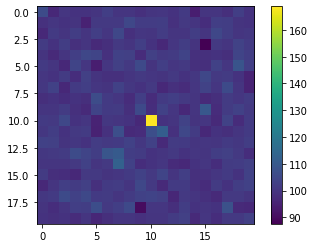

In [174]:
roi = bound_roi(snap, size=10)
bar = plt.imshow(roi)
plt.colorbar(bar)

In [170]:
np.unravel_index(snap.argmax(), snap.shape)

(1121, 82)

In [171]:
roi.shape

(20, 20)

In [183]:
np.average(roi)

100.93299999999999

# Solution FBI-Ba after realignment 

In [13]:
cam0.start_acquisition(mode='')

In [69]:
zdrive.move_absolute(2.34, Units.LENGTH_CENTIMETRES)


2.3400019875

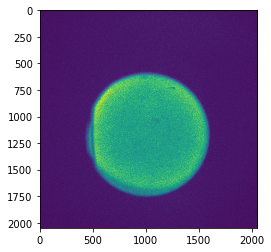

In [70]:
plt.imshow(cam0.get_frame(100))

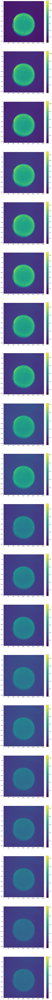

In [71]:
npos = 20
step = -100 # micron
fig, ax = plt.subplots(npos, figsize=(10, 10*npos))

zdrive.move_absolute(2.34, Units.LENGTH_CENTIMETRES)
sleep(5)
zscan = []
zmx = []
for i in range(npos):
    
    frame = cam0.get_frame(100)
    
    bar = ax[i].imshow(frame)
    plt.colorbar(bar, ax=ax[i])
    zscan.append(frame)
    zmx.append(frame.sum())
    zdrive.move_relative(step, Units.LENGTH_MICROMETRES)
    sleep(4)

[Text(0, 0.5, 'Total intensity [G.L.]'), Text(0.5, 0, 'z position [mm]')]

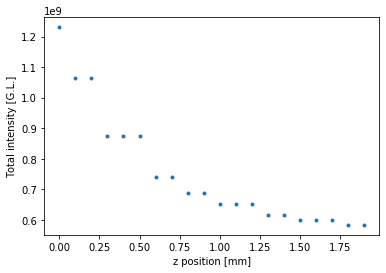

In [74]:
plt.plot(np.arange(len(zmx))*0.1, zmx, '.')
plt.gca().set(ylabel='Total intensity [G.L.]', xlabel='z position [mm]')

# Texp check

## Texp = 10 ms 

In [290]:
cam0.stop_acquisition()

In [291]:
cam0.set_value('EXPOSURE TIME', 0.001)
cam0.start_acquisition()

In [292]:
cam0._read_buffer(100)

CDCAMBUF_FRAME(iFrame=100, buf=1905327530048, rowbytes=4096, pixeltype=2, width=2048, height=2048, left=0, top=0, timestamp=CDCAM_TIMESTAMP(sec=1606379894, microsec=81814), framestamp=100, camerastamp=0, btot=8388608, bpp=2.0)

In [106]:
%%timeit
cam0.get_frame(100)

6.37 ms ± 212 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


51.3 ms ± 3.95 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


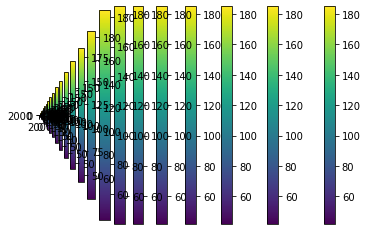

In [107]:
%%timeit 
f = cam0.get_frame(100)
b = plt.imshow(f)
plt.colorbar(b)

## Texp = 500 ms 

In [ ]:
#lib.dcamapi_init()     # For some reason this must be run before opening the camera
cam0 = cam.DCAMCamera(0)
cam0.open()

In [ ]:
cam.restart_lib()

In [ ]:
cam0.open()

In [280]:
cam0.handle

1904660477736

In [259]:
cam0.stop_acquisition()

In [281]:
cam0.get_status()

'unstable'

In [284]:
cam0.set_value('EXPOSURE TIME', 0.5)
#cam0.start_acquisition()

0.5000026466165414

In [283]:
cam0.get_value('EXPOSURE TIME')

0.009997714285714285

In [287]:
%%timeit
cam0._read_buffer(100)

3.23 ms ± 196 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


In [288]:

cam0._read_buffer(100)

CDCAMBUF_FRAME(iFrame=100, buf=1905327530048, rowbytes=4096, pixeltype=2, width=2048, height=2048, left=0, top=0, timestamp=CDCAM_TIMESTAMP(sec=1606379786, microsec=287817), framestamp=400, camerastamp=0, btot=8388608, bpp=2.0)

In [289]:

cam0._read_buffer(100)

CDCAMBUF_FRAME(iFrame=100, buf=1905327530048, rowbytes=4096, pixeltype=2, width=2048, height=2048, left=0, top=0, timestamp=CDCAM_TIMESTAMP(sec=1606379837, microsec=789215), framestamp=500, camerastamp=0, btot=8388608, bpp=2.0)

54.3 ms ± 3.53 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


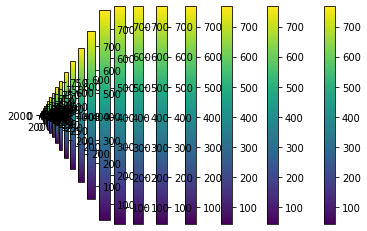

In [96]:
%%timeit
f = cam0.get_frame(100)
b = plt.imshow(f)
plt.colorbar(b)

In [113]:
import time

In [170]:
time.thread_time()

242.921875

In [112]:
cam.time.process_time_ns()

740140625000

## Snap 10 ms 

In [331]:
cam0.stop_acquisition()
cam0.set_value('EXPOSURE TIME', 0.001)
#cam0.start_acquisition(mode='snap')

0.0010036691729323308

In [325]:
cam0.start_acquisition(mode='snap')

In [326]:
cam0.get_status()

'busy'

In [328]:
cam0.stop_acquisition()

In [322]:
cam0.wait_for_frame()


In [332]:
%%timeit
cam0.snap(nframes=1)

395 ms ± 4.97 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


## Snap 500 ms

In [333]:
#cam0.stop_acquisition()
cam0.set_value('EXPOSURE TIME', 0.5)
#cam0.start_acquisition(mode='snap')

0.5000026466165414

In [334]:
%%timeit
cam0.snap(nframes=1)

981 ms ± 8.22 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


# Test z scan with snap 

In [342]:
cam0.stop_acquisition()
cam0.snap(nframes=1)

array([[[120, 111, 118, ..., 127, 141, 118],
        [114, 109, 129, ..., 141, 150, 142],
        [130, 125, 139, ..., 113, 149, 148],
        ...,
        [127, 143, 117, ..., 120, 121, 123],
        [118, 127, 132, ..., 127, 121, 118],
        [126, 149, 113, ..., 114, 125, 111]]], dtype=uint16)

In [335]:
cam0.set_value('EXPOSURE TIME', 0.5)

0.5000026466165414

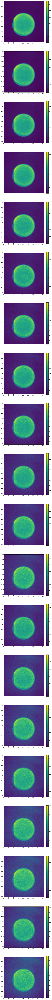

In [343]:
npos = 20
step = -100 # micron
fig, ax = plt.subplots(npos, figsize=(10, 10*npos))

zdrive.move_absolute(2.34, Units.LENGTH_CENTIMETRES)
sleep(1)
zscan = []
zmx = []
for i in range(npos):
    
    frame = cam0.snap(nframes=1)
    
    bar = ax[i].imshow(frame[0])
    plt.colorbar(bar, ax=ax[i])
    zscan.append(frame[0])
    zmx.append(frame[0].sum())
    zdrive.move_relative(step, Units.LENGTH_MICROMETRES)
    sleep(0.001)

[Text(0, 0.5, 'Total intensity [G.L.]'), Text(0.5, 0, 'z position [mm]')]

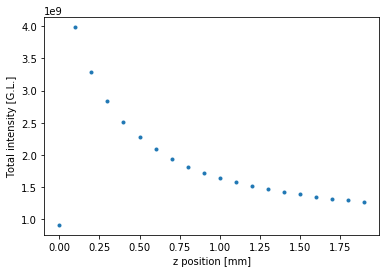

In [344]:
plt.plot(np.arange(len(zmx))*0.1, zmx, '.')
plt.gca().set(ylabel='Total intensity [G.L.]', xlabel='z position [mm]')

#####  Much smoother, seems that with the snap mode, the sleep is unnecessary for the camera command but not for the z motor

## Try zdrive.wait_until_idle()

In [367]:
cam0.set_value('EXPOSURE TIME', 0.1)

0.10000637593984962

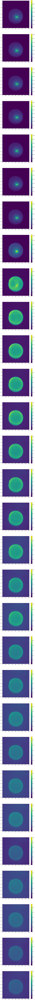

In [368]:
cam0.stop_acquisition()
npos = 30
step = -100 # micron
fig, ax = plt.subplots(npos, figsize=(10, 10*npos))

zdrive.move_absolute(2.44, Units.LENGTH_CENTIMETRES)
zdrive.wait_until_idle()   # Does not seem to work
zscan = []
zmx = []
for i in range(npos):
    
    frame = cam0.snap(nframes=1)
    
    bar = ax[i].imshow(frame[0])
    plt.colorbar(bar, ax=ax[i])
    zscan.append(frame[0])
    zmx.append(frame[0].sum())
    zdrive.move_relative(step, Units.LENGTH_MICROMETRES)
    zdrive.wait_until_idle()

[Text(0, 0.5, 'Total intensity [G.L.]'), Text(0.5, 0, 'z position [mm]')]

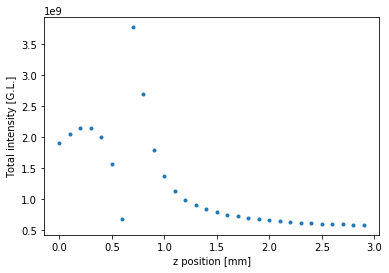

In [369]:
plt.plot(np.arange(len(zmx))*0.1, zmx, '.')
plt.gca().set(ylabel='Total intensity [G.L.]', xlabel='z position [mm]')

In [370]:
zdrive.move_absolute(2.44, Units.LENGTH_CENTIMETRES)

2.4400002

In [362]:
zdrive.home()
zdrive.wait_until_idle()
print('Finished')

Finished


In [375]:
zdrive.move_absolute(2.54, Units.LENGTH_CENTIMETRES)
#zdrive.wait_until_idle()
print('Finished')

Finished


##### wait_until_idle is not needed, 'Finished' is not printed until the motor stops moving
Perhaps some processes wait for zdrive and some others don't ???

# Try texp = 100 ms and cover wider z range 

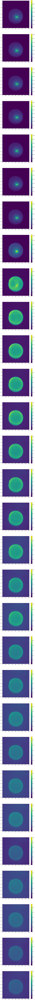

In [368]:
cam0.stop_acquisition()
npos = 30
step = -100 # micron
fig, ax = plt.subplots(npos, figsize=(10, 10*npos))

zdrive.move_absolute(2.44, Units.LENGTH_CENTIMETRES)
zdrive.wait_until_idle()   # Does not seem to work
zscan = []
zmx = []
for i in range(npos):
    
    frame = cam0.snap(nframes=1)
    
    bar = ax[i].imshow(frame[0])
    plt.colorbar(bar, ax=ax[i])
    zscan.append(frame[0])
    zmx.append(frame[0].sum())
    zdrive.move_relative(step, Units.LENGTH_MICROMETRES)
    zdrive.wait_until_idle()

[Text(0, 0.5, 'Total intensity [G.L.]'), Text(0.5, 0, 'z position [mm]')]

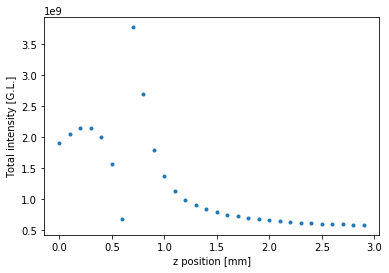

In [369]:
plt.plot(np.arange(len(zmx))*0.1, zmx, '.')
plt.gca().set(ylabel='Total intensity [G.L.]', xlabel='z position [mm]')

## A bit wider and slower step

In [6]:
cam0.stop_acquisition()
cam0.set_value('EXPOSURE TIME', 0.1)

0.10000637593984962

DCAMTimeoutError: 

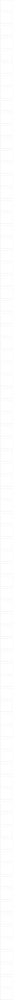

In [373]:
cam0.stop_acquisition()
npos = 80
step = -50 # micron
fig, ax = plt.subplots(npos, figsize=(10, 10*npos))

zdrive.move_absolute(2.54, Units.LENGTH_CENTIMETRES)
zdrive.wait_until_idle()   # Does not seem to work
zscan = []
zmx = []
for i in range(npos):
    
    frame = cam0.snap(nframes=1)
    
    #bar = ax[i].imshow(frame[0])
    #plt.colorbar(bar, ax=ax[i])
    zscan.append(frame[0])
    zmx.append(frame[0].sum())
    zdrive.move_relative(step, Units.LENGTH_MICROMETRES)
    zdrive.wait_until_idle()

[Text(0, 0.5, 'Total intensity [G.L.]'), Text(0.5, 0, 'z position [mm]')]

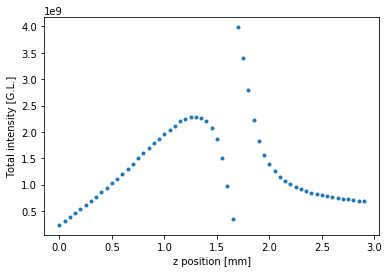

In [374]:
plt.plot(np.arange(len(zmx))*0.05, zmx, '.')
plt.gca().set(ylabel='Total intensity [G.L.]', xlabel='z position [mm]')

In [379]:
cam0.set_value('EXPOSURE TIME', 0.1)

0.10000637593984962

DCAMTimeoutError: 

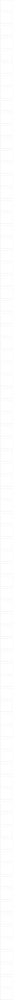

In [7]:
cam0.stop_acquisition()
npos = 80
step = -50 # micron
fig, ax = plt.subplots(npos, figsize=(10, 10*npos))

zdrive.move_absolute(2.54, Units.LENGTH_CENTIMETRES)
zdrive.wait_until_idle()   # Does not seem to work
zscan = []
zmx = []
for i in range(npos):
    
    frame = cam0.snap(nframes=1)
    
    #bar = ax[i].imshow(frame[0])
    #plt.colorbar(bar, ax=ax[i])
    zscan.append(frame[0])
    zmx.append(frame[0].sum())
    zdrive.move_relative(step, Units.LENGTH_MICROMETRES)
    zdrive.wait_until_idle()

In [8]:
conn.close( )

# Improve: flag error if over range in z drive